# Imports

In [2]:
import os
import sys

import numpy as np

from deepverse import ParameterManager
from deepverse.scenario import ScenarioManager
from deepverse import Dataset

from deepverse.visualizers import ImageVisualizer, LidarVisualizer

In [3]:
# Path to the configuration file
scenario_name = "DT31"
config_path = f"scenarios/{scenario_name}/param/config.m"

# Initialize ParameterManager and load parameters
param_manager = ParameterManager(config_path)
params = param_manager.get_params()

# Print the loaded parameters
print(params)

{'dataset_folder': 'scenarios', 'scenario': 'DT31', 'scenes': [1, 2], 'basestations': [1], 'comm': {'enable': True, 'bs_antenna': {'shape': [16, 1], 'rotation': [0, 0, -45.04], 'spacing': 0.5, 'FoV': [360, 180]}, 'ue_antenna': {'shape': [1, 1], 'rotation': [0, 0, 0], 'spacing': 0.5, 'FoV': [360, 180]}, 'OFDM': {'bandwidth': 0.05, 'subcarriers': 512, 'selected_subcarriers': [0, 1, 2, 3, 4, 5, 6, 7]}, 'activate_RX_filter': 0, 'generate_OFDM_channels': 1, 'num_paths': 25, 'enable_Doppler': 1}, 'radar': {'enable': True, 'tx_antenna': {'shape': [1, 1], 'rotation': [0, 0, -45.04], 'spacing': 0.5, 'FoV': [180, 180]}, 'rx_antenna': {'shape': [16, 1], 'rotation': [0, 0, -45.04], 'spacing': 0.5, 'FoV': [180, 180]}, 'FMCW': {'chirp_slope': 8014000000000.0, 'Fs': 6200000.0, 'n_samples_per_chirp': 256, 'n_chirps': 256}, 'num_paths': 50000}, 'camera': True, 'camera_id': ['unit1_cam1'], 'lidar': True, 'lidar_id': ['unit1_lidar1'], 'position': True}


# data shape

In [7]:
for k, v in params.items():
    print(f"{k}: {v}")


dataset_folder: scenarios
scenario: DT31
scenes: [1, 2]
basestations: [1]
comm: {'enable': True, 'bs_antenna': {'shape': [16, 1], 'rotation': [0, 0, -45.04], 'spacing': 0.5, 'FoV': [360, 180]}, 'ue_antenna': {'shape': [1, 1], 'rotation': [0, 0, 0], 'spacing': 0.5, 'FoV': [360, 180]}, 'OFDM': {'bandwidth': 0.05, 'subcarriers': 512, 'selected_subcarriers': [0, 1, 2, 3, 4, 5, 6, 7]}, 'activate_RX_filter': 0, 'generate_OFDM_channels': 1, 'num_paths': 25, 'enable_Doppler': 1}
radar: {'enable': True, 'tx_antenna': {'shape': [1, 1], 'rotation': [0, 0, -45.04], 'spacing': 0.5, 'FoV': [180, 180]}, 'rx_antenna': {'shape': [16, 1], 'rotation': [0, 0, -45.04], 'spacing': 0.5, 'FoV': [180, 180]}, 'FMCW': {'chirp_slope': 8014000000000.0, 'Fs': 6200000.0, 'n_samples_per_chirp': 256, 'n_chirps': 256}, 'num_paths': 50000}
camera: True
camera_id: ['unit1_cam1']
lidar: True
lidar_id: ['unit1_lidar1']
position: True


In [8]:
# modifiy the parameters
# param_manager.params['scenes'] = list(range(0, 10))
# param_manager.params['radar']['enabled'] = True


# Generate a dataset

In [9]:
dataset = Dataset(config_path)

Generating camera dataset: ⏳ In progress
Generating camera dataset: ✅ Completed (0.00s)
Generating LiDAR dataset: ⏳ In progress
Generating LiDAR dataset: ✅ Completed (0.00s)
Generating mobility dataset: ⏳ In progress
Generating mobility dataset: ✅ Completed (0.00s)
Generating comm dataset: ⏳ In progress


Generating comm dataset: ✅ Completed (0.11s)
Generating radar dataset: ⏳ In progress


Generating radar dataset: ✅ Completed (5.15s)


In [10]:
dataset.__dict__

{'param_manager': <deepverse.parameter.parameter_manager.ParameterManager at 0x7ba8f7a6f560>,
 'params': {'dataset_folder': 'scenarios',
  'scenario': 'DT31',
  'scenes': [1, 2],
  'basestations': [1],
  'comm': {'enable': True,
   'bs_antenna': {'shape': [16, 1],
    'rotation': array([  0.  ,   0.  , -45.04]),
    'spacing': 0.5,
    'FoV': [360, 180]},
   'ue_antenna': {'shape': [1, 1],
    'rotation': array([0, 0, 0]),
    'spacing': 0.5,
    'FoV': [360, 180]},
   'OFDM': {'bandwidth': 0.05,
    'subcarriers': 512,
    'selected_subcarriers': [0, 1, 2, 3, 4, 5, 6, 7]},
   'activate_RX_filter': 0,
   'generate_OFDM_channels': 1,
   'num_paths': 25,
   'enable_Doppler': 1},
  'radar': {'enable': True,
   'tx_antenna': {'shape': [1, 1],
    'rotation': array([  0.  ,   0.  , -45.04]),
    'spacing': 0.5,
    'FoV': [180, 180]},
   'rx_antenna': {'shape': [16, 1],
    'rotation': array([  0.  ,   0.  , -45.04]),
    'spacing': 0.5,
    'FoV': [180, 180]},
   'FMCW': {'chirp_slope': 80

# communication dataset

In [12]:
comm = dataset.comm_dataset

In [20]:
help(comm)

Help on CommunicationDataset in module deepverse.datasets.wireless_datasets object:

class CommunicationDataset(builtins.object)
 |  CommunicationDataset(params)
 |
 |  Methods defined here:
 |
 |  __init__(self, params)
 |      Initialize self.  See help(type(self)) for accurate signature.
 |
 |  get_bs_channel(self, tx_idx, rx_idx, time_idx)
 |
 |  get_bs_location(self, bs_idx, time_idx)
 |
 |  get_ue_channel(self, ue_idx, bs_idx, time_idx)
 |
 |  get_ue_location(self, ue_idx, bs_idx, time_idx)
 |
 |  ----------------------------------------------------------------------
 |  Data descriptors defined here:
 |
 |  __dict__
 |      dictionary for instance variables
 |
 |  __weakref__
 |      list of weak references to the object



In [25]:
comm.data

[[{'bs_loc': array([-57.771 ,  96.141 ,   3.4537], dtype=float32),
   'ue': [<deepverse.wireless.Channel.OFDMChannel at 0x7ba8f94191c0>],
   'ue_loc': array([[-44.6594,  93.8778,   1.68  ]], dtype=float32),
   'bs': [<deepverse.wireless.Channel.OFDMChannel at 0x7ba8ef4a9dc0>]}],
 [{'bs_loc': array([-57.771 ,  96.141 ,   3.4537], dtype=float32),
   'ue': [<deepverse.wireless.Channel.OFDMChannel at 0x7ba8ef4a9760>],
   'ue_loc': array([[-44.6245,  93.4295,   1.68  ]], dtype=float32),
   'bs': [<deepverse.wireless.Channel.OFDMChannel at 0x7ba8ef4a9cd0>]}]]

In [ ]:
# 수신신호(다운링크) : ue 송신신호(업링크) : bs
ch = comm.data[0][0]['ue'][0]
print(type(ch))
print([x for x in dir(ch) if not x.startswith("_")][:50])  # 너무 길면 50개만

<class 'deepverse.wireless.Channel.OFDMChannel'>
['LoS_status', 'bandwidth', 'carrier_freq', 'coeffs', 'doppler_shift', 'generate', 'params', 'paths', 'rx_antenna', 'rx_filter', 'subcarrier_freq', 'subcarriers', 'total_subcarriers', 'tx_antenna']


In [ ]:
# 다운링크에 대해
ch = comm.data[0][0]['ue'][0]  # 예시

# 1) coeffs
print("coeffs shape:", ch.coeffs.shape)
print("coeffs head1:", ch.coeffs.reshape(-1)[0])  # 가장 안전한 head1

# 2) LoS_status (배열/스칼라 둘 다 대응)
try:
    print("LoS_status shape:", ch.LoS_status.shape)
    print("LoS_status head1:", ch.LoS_status.reshape(-1)[0])
except Exception:
    print("LoS_status:", ch.LoS_status)

# 3) doppler_shift
try:
    print("doppler_shift shape:", ch.doppler_shift.shape)
    print("doppler_shift head1:", ch.doppler_shift.reshape(-1)[0])
except Exception:
    print("doppler_shift:", ch.doppler_shift)

# 4) carrier_freq (보통 스칼라)
print("carrier_freq:", ch.carrier_freq)

# 5) bandwidth (보통 스칼라/None)
print("bandwidth:", ch.bandwidth)

# 6) subcarrier_freq (배열일 가능성 큼)
try:
    print("subcarrier_freq shape:", ch.subcarrier_freq.shape)
    print("subcarrier_freq head1:", ch.subcarrier_freq.reshape(-1)[0])
except Exception:
    print("subcarrier_freq:", ch.subcarrier_freq)

# 7) subcarriers (배열/리스트일 가능성)
try:
    print("subcarriers shape:", ch.subcarriers.shape)
    print("subcarriers head1:", ch.subcarriers.reshape(-1)[0])
except Exception:
    try:
        print("subcarriers len:", len(ch.subcarriers))
        print("subcarriers head1:", ch.subcarriers[0])
    except Exception:
        print("subcarriers:", ch.subcarriers)

# 8) total_subcarriers (정수일 가능성)
print("total_subcarriers:", ch.total_subcarriers)

# 9) params (dict일 가능성)
try:
    print("params keys:", list(ch.params.keys())[:30])
    k0 = next(iter(ch.params))
    print("params head1:", (k0, ch.params[k0]))
except Exception:
    print("params:", ch.params)

# 10) paths (객체일 가능성 → 타입/내부 보기)
print("paths type:", type(ch.paths))
try:
    print("paths attrs:", list(ch.paths.__dict__.keys())[:30])
except Exception:
    print("paths dir:", [x for x in dir(ch.paths) if not x.startswith("_")][:30])

# 11) tx_antenna (객체)
print("tx_antenna type:", type(ch.tx_antenna))
try:
    print("tx_antenna attrs:", list(ch.tx_antenna.__dict__.keys())[:30])
except Exception:
    print("tx_antenna dir:", [x for x in dir(ch.tx_antenna) if not x.startswith("_")][:30])

# 12) rx_antenna (객체)
print("rx_antenna type:", type(ch.rx_antenna))
try:
    print("rx_antenna attrs:", list(ch.rx_antenna.__dict__.keys())[:30])
except Exception:
    print("rx_antenna dir:", [x for x in dir(ch.rx_antenna) if not x.startswith("_")][:30])

# 13) rx_filter (객체/배열 둘 다 가능)
print("rx_filter type:", type(ch.rx_filter))
try:
    print("rx_filter shape:", ch.rx_filter.shape)
    print("rx_filter head1:", ch.rx_filter.reshape(-1)[0])
except Exception:
    try:
        print("rx_filter attrs:", list(ch.rx_filter.__dict__.keys())[:30])
    except Exception:
        print("rx_filter dir:", [x for x in dir(ch.rx_filter) if not x.startswith("_")][:30])



coeffs shape: (1, 16, 8)
coeffs head1: (-1.176407846449244e-06-8.535860066815936e-07j)
LoS_status: -1
doppler_shift: 1
carrier_freq: 60000000000.0
bandwidth: 50000000.0
subcarrier_freq shape: (1, 8)
subcarrier_freq head1: 0.0
subcarriers len: 8
subcarriers head1: 0
total_subcarriers: 512
params keys: ['basestations', 'dataset_folder', 'scenario', 'scenes', 'enable', 'bs_antenna', 'ue_antenna', 'OFDM', 'activate_RX_filter', 'generate_OFDM_channels', 'num_paths', 'enable_Doppler', 'user_rows', 'scenario_params_path', 'scenario_params', 'tx_ant_objs', 'active_UE', 'rx_ant_objs']
params head1: ('basestations', array([1]))
paths type: <class 'deepverse.wireless.Paths.Paths'>
paths attrs: ['power', 'phase', 'ToA', 'DoD_theta', 'DoD_phi', 'DoA_theta', 'DoA_phi', 'doppler_vel', 'doppler_acc', 'carrier_freq', 'wavelength', 'antenna_applied']
tx_antenna type: <class 'deepverse.wireless.Antenna.Antenna'>
tx_antenna attrs: ['shape', 'rotation', 'FoV', 'spacing', '_element_idx', '_kd']
rx_antenna t

In [46]:
p = ch.paths
i = 0
print("power:", p.power[i])
print("phase:", p.phase[i])
print("ToA:", p.ToA[i])
print("DoD(theta,phi):", p.DoD_theta[i], p.DoD_phi[i])
print("DoA(theta,phi):", p.DoA_theta[i], p.DoA_phi[i])
print("doppler_vel:", p.doppler_vel[i])
print("doppler_acc:", p.doppler_acc[i])


power: 8.392863e-10
phase: -131.733
ToA: 4.47894e-08
DoD(theta,phi): 1.703321 0.6151711
DoA(theta,phi): 1.4382715 2.9706726
doppler_vel: 1.0563956
doppler_acc: 0.0


In [44]:
# 다운링크에 대해
ch_bs = comm.data[0][0]['bs'][0]  # 예시

# 1) coeffs
print("coeffs shape:", ch_bs.coeffs.shape)
print("coeffs head1:", ch_bs.coeffs.reshape(-1)[0])

# 2) LoS_status
try:
    print("LoS_status shape:", ch_bs.LoS_status.shape)
    print("LoS_status head1:", ch_bs.LoS_status.reshape(-1)[0])
except Exception:
    print("LoS_status:", ch_bs.LoS_status)

# 3) doppler_shift
try:
    print("doppler_shift shape:", ch_bs.doppler_shift.shape)
    print("doppler_shift head1:", ch_bs.doppler_shift.reshape(-1)[0])
except Exception:
    print("doppler_shift:", ch_bs.doppler_shift)

# 4) carrier_freq
print("carrier_freq:", ch_bs.carrier_freq)

# 5) bandwidth
print("bandwidth:", ch_bs.bandwidth)

# 6) subcarrier_freq
try:
    print("subcarrier_freq shape:", ch_bs.subcarrier_freq.shape)
    print("subcarrier_freq head1:", ch_bs.subcarrier_freq.reshape(-1)[0])
except Exception:
    print("subcarrier_freq:", ch_bs.subcarrier_freq)

# 7) subcarriers
try:
    print("subcarriers shape:", ch_bs.subcarriers.shape)
    print("subcarriers head1:", ch_bs.subcarriers.reshape(-1)[0])
except Exception:
    try:
        print("subcarriers len:", len(ch_bs.subcarriers))
        print("subcarriers head1:", ch_bs.subcarriers[0])
    except Exception:
        print("subcarriers:", ch_bs.subcarriers)

# 8) total_subcarriers
print("total_subcarriers:", ch_bs.total_subcarriers)

# 9) params
try:
    print("params keys:", list(ch_bs.params.keys())[:30])
    k0 = next(iter(ch_bs.params))
    print("params head1:", (k0, ch_bs.params[k0]))
except Exception:
    print("params:", ch_bs.params)

# 10) paths
print("paths type:", type(ch_bs.paths))
try:
    print("paths attrs:", list(ch_bs.paths.__dict__.keys())[:30])
except Exception:
    print("paths dir:", [x for x in dir(ch_bs.paths) if not x.startswith("_")][:30])

# 11) tx_antenna
print("tx_antenna type:", type(ch_bs.tx_antenna))
try:
    print("tx_antenna attrs:", list(ch_bs.tx_antenna.__dict__.keys())[:30])
except Exception:
    print("tx_antenna dir:", [x for x in dir(ch_bs.tx_antenna) if not x.startswith("_")][:30])

# 12) rx_antenna
print("rx_antenna type:", type(ch_bs.rx_antenna))
try:
    print("rx_antenna attrs:", list(ch_bs.rx_antenna.__dict__.keys())[:30])
except Exception:
    print("rx_antenna dir:", [x for x in dir(ch_bs.rx_antenna) if not x.startswith("_")][:30])

# 13) rx_filter
print("rx_filter type:", type(ch_bs.rx_filter))
try:
    print("rx_filter shape:", ch_bs.rx_filter.shape)
    print("rx_filter head1:", ch_bs.rx_filter.reshape(-1)[0])
except Exception:
    try:
        print("rx_filter attrs:", list(ch_bs.rx_filter.__dict__.keys())[:30])
    except Exception:
        print("rx_filter dir:", [x for x in dir(ch_bs.rx_filter) if not x.startswith("_")][:30])

coeffs shape: (16, 16, 8)
coeffs head1: (-9.241837160610946e-07-2.8756219374079657e-07j)
LoS_status: -1
doppler_shift: 1
carrier_freq: 60000000000.0
bandwidth: 50000000.0
subcarrier_freq shape: (1, 8)
subcarrier_freq head1: 0.0
subcarriers len: 8
subcarriers head1: 0
total_subcarriers: 512
params keys: ['basestations', 'dataset_folder', 'scenario', 'scenes', 'enable', 'bs_antenna', 'ue_antenna', 'OFDM', 'activate_RX_filter', 'generate_OFDM_channels', 'num_paths', 'enable_Doppler', 'user_rows', 'scenario_params_path', 'scenario_params', 'tx_ant_objs', 'active_UE', 'rx_ant_objs']
params head1: ('basestations', array([1]))
paths type: <class 'deepverse.wireless.Paths.Paths'>
paths attrs: ['power', 'phase', 'ToA', 'DoD_theta', 'DoD_phi', 'DoA_theta', 'DoA_phi', 'doppler_vel', 'doppler_acc', 'carrier_freq', 'wavelength', 'antenna_applied']
tx_antenna type: <class 'deepverse.wireless.Antenna.Antenna'>
tx_antenna attrs: ['shape', 'rotation', 'FoV', 'spacing', '_element_idx', '_kd']
rx_antenna

# radar Dataset

In [47]:
radar = dataset.radar_dataset
radar.__dict__

{'params': {'basestations': array([1]),
  'dataset_folder': 'scenarios',
  'scenario': 'DT31',
  'scenes': [1, 2],
  'enable': True,
  'tx_antenna': {'shape': [1, 1],
   'rotation': array([  0.  ,   0.  , -45.04]),
   'spacing': 0.5,
   'FoV': [180, 180]},
  'rx_antenna': {'shape': [16, 1],
   'rotation': array([  0.  ,   0.  , -45.04]),
   'spacing': 0.5,
   'FoV': [180, 180]},
  'FMCW': {'chirp_slope': 8014000000000.0,
   'Fs': 6200000.0,
   'n_samples_per_chirp': 256,
   'n_chirps': 256},
  'num_paths': 50000,
  'user_rows': array([0]),
  'scenario_params_path': '/home/yuknow01/Deepverse/scenarios/DT31/wireless/params.mat',
  'scenario_params': {'carrier_freq': 60000000000.0,
   'tx_power': 0.0,
   'num_BS': 1,
   'user_grids': array([[1, 1, 1]]),
   'doppler_available': 1,
   'dual_polar_available': 0},
  'tx_ant_objs': [<deepverse.wireless.Antenna.Antenna at 0x7ba8f8b2f6b0>],
  'rx_ant_objs': [<deepverse.wireless.Antenna.Antenna at 0x7ba8f8b2e480>]},
 'data': [[[<deepverse.wireles

In [52]:
radar_ch = radar.data[0][0][0]
print([x for x in dir(radar_ch) if not x.startswith("_")])


['LoS_status', 'bandwidth', 'carrier_freq', 'coeffs', 'generate', 'params', 'paths', 'rx_antenna', 'tx_antenna', 'waveform']


In [54]:
print("coeffs shape:", radar_ch.coeffs.shape)
print("coeffs head1:", radar_ch.coeffs.reshape(-1)[0])


coeffs shape: (16, 1, 256, 256)
coeffs head1: (2.2430005255584542e-05+1.277697717755427e-05j)


In [55]:
# radar 채널 객체 가져오기 (사진 기준)
radar_ch = radar.data[0][0][0]  

print([x for x in dir(radar_ch) if not x.startswith("__")])

# 1) coeffs
print("coeffs shape:", radar_ch.coeffs.shape)
print("coeffs head1:", radar_ch.coeffs.reshape(-1)[0])

# 2) LoS_status
try:
    print("LoS_status shape:", radar_ch.LoS_status.shape)
    print("LoS_status head1:", radar_ch.LoS_status.reshape(-1)[0])
except Exception:
    print("LoS_status:", radar_ch.LoS_status)

# 3) carrier_freq
try:
    print("carrier_freq:", radar_ch.carrier_freq)
except Exception as e:
    print("carrier_freq: <missing>", e)

# 4) bandwidth
try:
    print("bandwidth:", radar_ch.bandwidth)
except Exception as e:
    print("bandwidth: <missing>", e)

# 5) params
try:
    print("params keys:", list(radar_ch.params.keys())[:30])
    k0 = next(iter(radar_ch.params))
    print("params head1:", (k0, radar_ch.params[k0]))
except Exception:
    print("params:", getattr(radar_ch, "params", None))

# 6) paths
print("paths type:", type(radar_ch.paths))
try:
    print("paths attrs:", list(radar_ch.paths.__dict__.keys())[:30])
except Exception:
    print("paths dir:", [x for x in dir(radar_ch.paths) if not x.startswith("_")][:30])

# 7) tx_antenna
print("tx_antenna type:", type(radar_ch.tx_antenna))
try:
    print("tx_antenna attrs:", list(radar_ch.tx_antenna.__dict__.keys())[:30])
except Exception:
    print("tx_antenna dir:", [x for x in dir(radar_ch.tx_antenna) if not x.startswith("_")][:30])

# 8) rx_antenna
print("rx_antenna type:", type(radar_ch.rx_antenna))
try:
    print("rx_antenna attrs:", list(radar_ch.rx_antenna.__dict__.keys())[:30])
except Exception:
    print("rx_antenna dir:", [x for x in dir(radar_ch.rx_antenna) if not x.startswith("_")][:30])

# 9) waveform
print("waveform type:", type(radar_ch.waveform))
try:
    print("waveform attrs:", list(radar_ch.waveform.__dict__.keys())[:30])
except Exception:
    print("waveform dir:", [x for x in dir(radar_ch.waveform) if not x.startswith("_")][:30])

# 10) generate (메서드 존재 여부만)
try:
    print("generate:", radar_ch.generate, "| callable:", callable(radar_ch.generate))
except Exception as e:
    print("generate: <missing>", e)

# (옵션) 혹시 doppler_shift 같은 게 있을 수도 있으니 있으면 찍기
for name in ["doppler_shift", "subcarrier_freq", "subcarriers", "total_subcarriers"]:
    if hasattr(radar_ch, name):
        obj = getattr(radar_ch, name)
        try:
            print(f"{name} shape:", obj.shape)
            print(f"{name} head1:", obj.reshape(-1)[0])
        except Exception:
            try:
                print(f"{name} len:", len(obj))
                print(f"{name} head1:", obj[0])
            except Exception:
                print(f"{name}:", obj)


['LoS_status', 'bandwidth', 'carrier_freq', 'coeffs', 'generate', 'params', 'paths', 'rx_antenna', 'tx_antenna', 'waveform']
coeffs shape: (16, 1, 256, 256)
coeffs head1: (2.2430005255584542e-05+1.277697717755427e-05j)
LoS_status: -1
carrier_freq: 60000000000.0
bandwidth: None
params keys: ['basestations', 'dataset_folder', 'scenario', 'scenes', 'enable', 'tx_antenna', 'rx_antenna', 'FMCW', 'num_paths', 'user_rows', 'scenario_params_path', 'scenario_params', 'tx_ant_objs', 'rx_ant_objs']
params head1: ('basestations', array([1]))
paths type: <class 'deepverse.wireless.Paths.Paths'>
paths attrs: ['power', 'phase', 'ToA', 'DoD_theta', 'DoD_phi', 'DoA_theta', 'DoA_phi', 'doppler_vel', 'doppler_acc', 'carrier_freq', 'wavelength', 'antenna_applied']
tx_antenna type: <class 'deepverse.wireless.Antenna.Antenna'>
tx_antenna attrs: ['shape', 'rotation', 'FoV', 'spacing', '_element_idx', '_kd']
rx_antenna type: <class 'deepverse.wireless.Antenna.Antenna'>
rx_antenna attrs: ['shape', 'rotation', 

# lidar dataset

In [56]:
lidar = dataset.lidar_dataset
lidar.__dict__

{'params': {'dataset_folder': 'scenarios',
  'scenario': 'DT31',
  'scenes': [1, 2],
  'basestations': [1],
  'comm': {'enable': True,
   'bs_antenna': {'shape': [16, 1],
    'rotation': array([  0.  ,   0.  , -45.04]),
    'spacing': 0.5,
    'FoV': [360, 180]},
   'ue_antenna': {'shape': [1, 1],
    'rotation': array([0, 0, 0]),
    'spacing': 0.5,
    'FoV': [360, 180]},
   'OFDM': {'bandwidth': 0.05,
    'subcarriers': 512,
    'selected_subcarriers': [0, 1, 2, 3, 4, 5, 6, 7]},
   'activate_RX_filter': 0,
   'generate_OFDM_channels': 1,
   'num_paths': 25,
   'enable_Doppler': 1},
  'radar': {'enable': True,
   'tx_antenna': {'shape': [1, 1],
    'rotation': array([  0.  ,   0.  , -45.04]),
    'spacing': 0.5,
    'FoV': [180, 180]},
   'rx_antenna': {'shape': [16, 1],
    'rotation': array([  0.  ,   0.  , -45.04]),
    'spacing': 0.5,
    'FoV': [180, 180]},
   'FMCW': {'chirp_slope': 8014000000000.0,
    'Fs': 6200000.0,
    'n_samples_per_chirp': 256,
    'n_chirps': 256},
   '

In [59]:
# LiDAR dataset 객체
lidar_ds = dataset.lidar_dataset  # 너가 이미 사용한 방식

print("=== lidar_dataset members (public) ===")
print([x for x in dir(lidar_ds) if not x.startswith("_")])

print("\n=== lidar_dataset.__dict__ keys ===")
print(list(lidar_ds.__dict__.keys()))

# 1) params (설정)
try:
    print("\nparams keys:", list(lidar_ds.params.keys())[:50])
    print("params['scenario']:", lidar_ds.params.get("scenario", None))
    print("params['scenes']:", lidar_ds.params.get("scenes", None))
    print("params['comm']['enable']:", lidar_ds.params.get("comm", {}).get("enable", None))
    print("params['radar']['enable']:", lidar_ds.params.get("radar", {}).get("enable", None))
except Exception as e:
    print("params: <missing or not dict>", e)

# 2) device_type
print("\ndevice_type:", getattr(lidar_ds, "device_type", None))

# 3) sensors
sensors = getattr(lidar_ds, "sensors", None)
print("\nsensors type:", type(sensors))
try:
    print("sensor ids:", list(sensors.keys())[:20])
    sid0 = next(iter(sensors))
    print("sensor head1 id:", sid0)
    print("sensor head1:", sensors[sid0])
except Exception as e:
    print("sensors:", sensors, "| err:", e)

# 4) visualizer
viz = getattr(lidar_ds, "visualizer", None)
print("\nvisualizer type:", type(viz))
if viz is not None:
    try:
        print("visualizer attrs:", list(viz.__dict__.keys())[:50])
    except Exception:
        print("visualizer dir:", [x for x in dir(viz) if not x.startswith("_")][:50])

# 5) data (실제 LiDAR 샘플)
data = getattr(lidar_ds, "data", None)
print("\n=== lidar_ds.data ===")
print("data type:", type(data))

# data가 list/tuple처럼 길이를 갖는지
try:
    print("len(data):", len(data))
except Exception as e:
    print("len(data): <no len>", e)

# 샘플 하나 꺼내보기 (가능한 가장 안전한 방식)
sample = None
try:
    sample = data[0]
    print("\n=== sample = data[0] ===")
except Exception as e:
    print("\nCannot index data[0]:", e)

if sample is not None:
    print("sample type:", type(sample))

    # dict면 key들 확인
    if isinstance(sample, dict):
        print("sample keys:", list(sample.keys())[:50])
        k0 = next(iter(sample))
        print("sample head1:", (k0, sample[k0]))

    # numpy/torch처럼 shape가 있으면 shape + head1
    if hasattr(sample, "shape"):
        print("sample shape:", sample.shape)
        try:
            print("sample head1:", sample.reshape(-1)[0])
        except Exception:
            try:
                # reshape가 안 되면 flat 접근 시도
                import numpy as np
                print("sample head1:", np.ravel(sample)[0])
            except Exception as e:
                print("sample head1: <cannot flatten>", e)

    # list/tuple면 첫 원소 보기
    if isinstance(sample, (list, tuple)):
        print("sample len:", len(sample))
        if len(sample) > 0:
            print("sample[0] type:", type(sample[0]))
            if hasattr(sample[0], "shape"):
                print("sample[0] shape:", sample[0].shape)
            else:
                print("sample[0]:", sample[0])


=== lidar_dataset members (public) ===
['device_type', 'generate', 'get_sample', 'list_sensors', 'num_devices', 'params', 'save_sample', 'sensor_id', 'sensors', 'set_visualization_backend', 'visualize', 'visualizer']

=== lidar_dataset.__dict__ keys ===
['params', 'device_type', 'sensors', 'sensor_id', 'num_devices', 'visualizer']

params keys: ['dataset_folder', 'scenario', 'scenes', 'basestations', 'comm', 'radar', 'camera', 'camera_id', 'lidar', 'lidar_id', 'position']
params['scenario']: DT31
params['scenes']: [1, 2]
params['comm']['enable']: True
params['radar']['enable']: True

device_type: LiDAR

sensors type: <class 'dict'>
sensor ids: ['unit1_lidar1']
sensor head1 id: unit1_lidar1
sensor head1: Sensor(id=unit1_lidar1, properties={'rotation': [-1.1, 0, -124.7], 'location': [-56.784, 94.372, 1.012], 'FoV': 360, 'range': 80, 'upper_fov': 10, 'lower_fov': -75, 'channels': 32}, files=7012 files)

visualizer type: <class 'deepverse.visualizers.lidar_visualizer.LidarVisualizer'>
visu

# camera and lidar

In [ ]:
# 1) Access sample: Camera / LiDAR (get_sample)
camera_sample = dataset.get_sample('cam', index=0, device_index="unit1_cam1")  # Get sample from camera 1
print(camera_sample)

lidar_sample = dataset.get_sample('lidar', index=0, device_index="unit1_lidar1")  # Get sample from LiDAR 1
print(lidar_sample)


scenarios/DT31/RGB_images/unit1_cam1/1.png
scenarios/DT31/lidar/unit1_lidar1/1.pcd


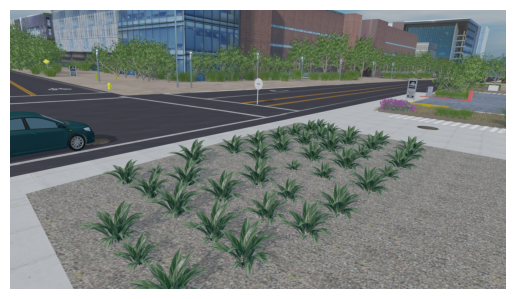

In [ ]:
#Visualize: Camera (matplotlib)
dataset.set_visualization_backend('cam', 'matplotlib')
dataset.visualize('cam', 'unit1_cam1', 0)


In [62]:
# This draw function is [only] needed for open3d to work in colab
def draw(geometries):
    graph_obj = []

    for gm in geometries:
        geometry_type = gm.get_geometry_type()

        if geometry_type == o3d.geometry.Geometry.Type.PointCloud:
            pts = np.asarray(gm.points)
            clr = None  #for colors
            if gm.has_colors():
                clr = np.asarray(gm.colors)
            elif gm.has_normals():
                clr = (0.5, 0.5, 0.5) + np.asarray(gm.normals) * 0.5
            else:
                gm.paint_uniform_color((1.0, 0.0, 0.0))
                clr = np.asarray(gm.colors)

            sc = go.Scatter3d(x=pts[:,0], y=pts[:,1], z=pts[:,2], mode='markers', marker=dict(size=1, color=clr))
            graph_obj.append(sc)

        if geometry_type == o3d.geometry.Geometry.Type.TriangleMesh:
            tri = np.asarray(gm.triangles)
            vert = np.asarray(gm.vertices)
            clr = None
            if gm.has_triangle_normals():
                clr = (0.5, 0.5, 0.5) + np.asarray(gm.triangle_normals) * 0.5
                clr = tuple(map(tuple, clr))
            else:
                clr = (1.0, 0.0, 0.0)

            mesh = go.Mesh3d(x=vert[:,0], y=vert[:,1], z=vert[:,2], i=tri[:,0], j=tri[:,1], k=tri[:,2], facecolor=clr, opacity=0.50)
            graph_obj.append(mesh)

    fig = go.Figure(
        data=graph_obj,
        layout=dict(
            scene=dict(
                xaxis=dict(visible=False),
                yaxis=dict(visible=False),
                zaxis=dict(visible=False)
            )
        )
    )
    fig.update_layout(scene_aspectmode="data")
    fig.show()

import numpy as np
import open3d as o3d
import plotly.graph_objects as go
o3d.visualization.draw_geometries = draw # replace function

dataset.set_visualization_backend('lidar', 'open3d')
dataset.visualize('lidar', 'unit1_lidar1', 0)


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
